In [1]:
from plant import *
from scipy.signal import cont2discrete

plant_params = {
                'sigma': 20, # Coeficiente de proporcionalidade da corrente de tunelamento
                'work_fn':4.7, # Função trabalho
                'Vb':.5, # Tensão de polarização
                'offset': 5, # distancia do piezo com relação a menor altura
                'm': .01, # Massa do piezo
                'b_': 10, # Coeficiente de viscosidade
                'a': .95, # Coeficiente de pós-escoamento
                'ki': 100, # rigidez
                'd': 100, # Coeficiente do piezo m/V

                # Constantes para medir o deslocamento inerente à histerese
                'alpha': 1, 
                'beta': 0.8,
                'gamma': 0.2,
                'n': 2,}

class DirectNN(nn.Module):

    def __init__(self, plant):
        super(DirectNN, self).__init__()

        self.net = nn.Sequential()

        self.fc1 = nn.Linear(10, 100)
        torch.nn.init.uniform_(self.fc1.weight, a=0, b=1e-2)
        self.net.add_module('Linear_1', self.fc1)
        self.net.add_module('Tanh1', nn.Tanh())


        self.fc2 = nn.Linear(100, 1)#, bias=False)
        torch.nn.init.uniform_(self.fc2.weight, a=0, b=1e-4)
        self.net.add_module('Linear_2', self.fc2)


        self.plant = plant
        
    def forward(self, x, h, dT):

        u = self.net(x) 
        out = self.plant(u, h, dT)
        return  u, out



class MSELoss(torch.nn.Module):
    def __init__(self):
        super(MSELoss, self).__init__()
        

    def forward(self, y_true, y_pred):
      # Calculate the euclidian distance and calculate the contrastive loss

        loss_contrastive = torch.pow(y_pred - y_true , 2)


        return loss_contrastive
    


In [2]:
offset = 5
stm_plant_model = STMPlant(hurwitz_constant=-1, plant_params=plant_params)

net = DirectNN(stm_plant_model)

final = 200
dt = 1e-3
t = torch.arange(0, final, dt)
atom_radius = 3
n_atoms = 40
correction_constant = (atom_radius*n_atoms)/final

w = np.pi*n_atoms/final
h = torch.sin(w*t)**2
h[final//2:] += 2*h[final//2:]
    
u = torch.tensor([1])


criterion = MSELoss()
optimizer = torch.optim.SGD(net.parameters(), lr = 1e-4)
x = torch.zeros(10, requires_grad=True)
y_p_list = torch.zeros_like(t)
z_list = torch.zeros_like(t)
u_list = torch.zeros_like(t)
e_list = torch.zeros_like(t)

K = 1
tau = .2
reference_model = cont2discrete(([K],[tau,1]), dt=dt, method='euler')
am = reference_model[0].squeeze()
bm = -reference_model[1].squeeze() # inverter por conta da forma do filtro IIR: 1 - b0 - b1 - ... - bn

y_d = torch.zeros_like(t) + torch.log(torch.tensor([1]))
xm = torch.zeros_like(torch.tensor(am))
ym = torch.zeros_like(torch.tensor(bm))

y_ref = torch.zeros_like(t)


for i, k in enumerate(t):
    print(x)
    
    
    xm = np.roll(xm,1)
    xm[0] = y_d[i]
    ym = np.roll(ym,1)
    if i == 0:
        ym[0] = stm_sim(0,0 , np.zeros(3), dt, plant_params)[0]
        
    else:
        ym[0] = np.dot(am, xm) + np.dot(bm[1:], ym[1:])

    y_ref[i] = ym[0] # Saída  do modelo de referência
    
    u, y_p = net(x, h[i], dt)

    #print(y_p[0], y_ref[i])

    optimizer.zero_grad()
    loss = criterion(ym[0], y_p[0])
    loss.backward()
    optimizer.step()
    
    with torch.no_grad():
        y_p_list[i] = y_p[0]
        past = x.clone()
        past[1:] = past[:-1].clone()
        if i >0:
            past[0] = y_ref[i] - y_p_list[i-1]
        else:
            past[0] = y_ref[i]- y_p_list[i]
        e_list[i] = past[0]
        u_list[i] = u
        
        z_list[i] =  torch.unsqueeze(y_p[-1][0],0)
        past[5] = u

        x.data = past.data

    


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], requires_grad=True)
tensor([0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0355, 0.0000, 0.0000, 0.0000,
        0.0000], requires_grad=True)
tensor([0.0440, 0.0000, 0.0000, 0.0000, 0.0000, 0.0355, 0.0355, 0.0000, 0.0000,
        0.0000], requires_grad=True)
tensor([0.0871, 0.0440, 0.0000, 0.0000, 0.0000, 0.0356, 0.0355, 0.0355, 0.0000,
        0.0000], requires_grad=True)
tensor([0.1299, 0.0871, 0.0440, 0.0000, 0.0000, 0.0356, 0.0356, 0.0355, 0.0355,
        0.0000], requires_grad=True)
tensor([0.1725, 0.1299, 0.0871, 0.0440, 0.0000, 0.0358, 0.0356, 0.0356, 0.0355,
        0.0355], requires_grad=True)
tensor([0.2149, 0.1725, 0.1299, 0.0871, 0.0440, 0.0359, 0.0358, 0.0356, 0.0356,
        0.0355], requires_grad=True)
tensor([0.2570, 0.2149, 0.1725, 0.1299, 0.0871, 0.0361, 0.0359, 0.0358, 0.0356,
        0.0356], requires_grad=True)
tensor([0.2990, 0.2570, 0.2149, 0.1725, 0.1299, 0.0364, 0.0361, 0.0359, 0.0358,
        0.0356], requires_grad=T

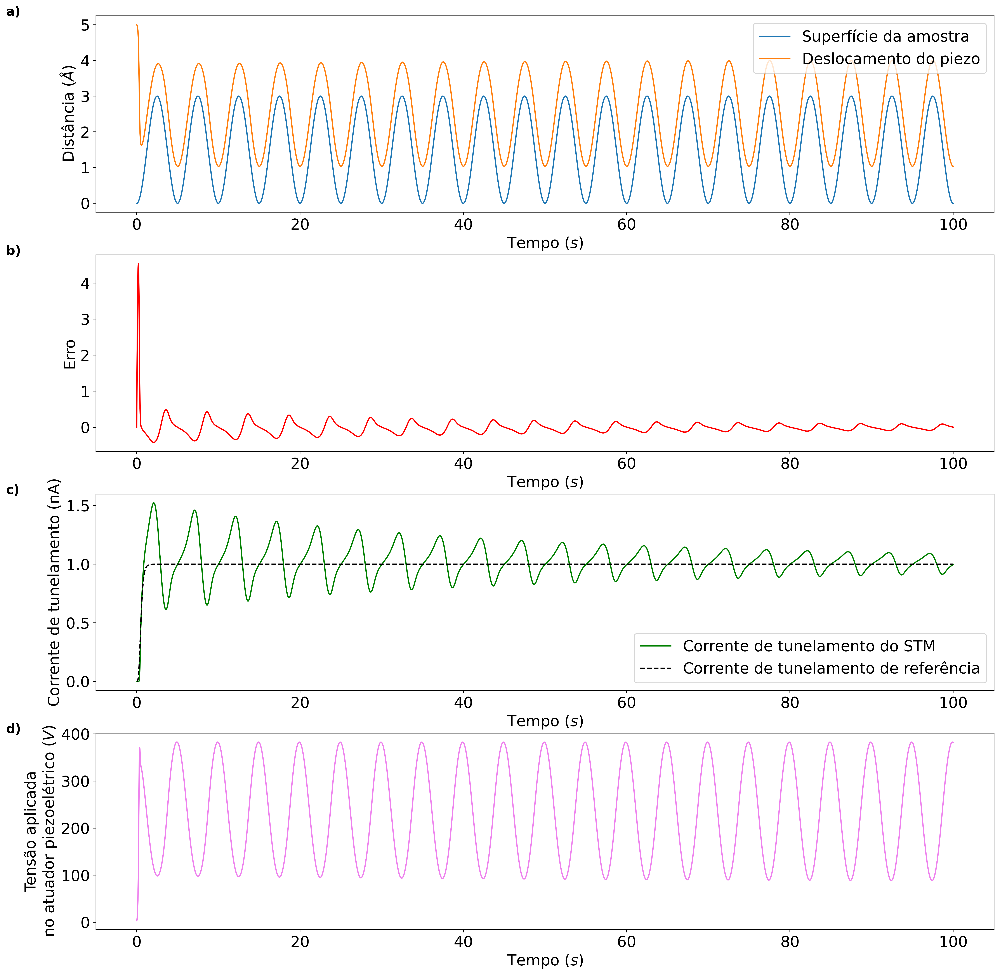

In [8]:
        
import matplotlib.pyplot as plt
import string

import matplotlib
matplotlib.rcParams.update({'font.size': 18})
fig, axs = plt.subplots(4,1)
fig.set_size_inches(16, 16)
fig.tight_layout()
fig.dpi = 400

axs[0].set_ylabel("Distância ($\AA$)")
axs[0].set_xlabel("Tempo ($s$)")
axs[0].plot(t, h.detach().cpu().numpy(), t, 5 -z_list.detach().cpu().numpy())
axs[0].legend(["Superfície da amostra", "Deslocamento do piezo"])

axs[1].set_ylabel("Erro")
axs[1].set_xlabel("Tempo ($s$)")
axs[1].plot(t, e_list.detach().cpu().numpy(), 'r')

axs[2].set_ylabel("Corrente de tunelamento (nA)")
axs[2].set_xlabel("Tempo ($s$)")
axs[2].plot(t, np.exp(y_p_list.detach().cpu().numpy()), 'g', t, np.exp(y_ref.detach().cpu().numpy()),'k--')
axs[2].legend(["Corrente de tunelamento do STM", "Corrente de tunelamento de referência"])

axs[3].set_ylabel("Tensão aplicada\nno atuador piezoelétrico ($V$)")
axs[3].set_xlabel("Tempo ($s$)")
axs[3].plot(t, plant_params['d']*u_list.detach().cpu().numpy(), 'violet')

for n, ax in enumerate(axs):
    ax.text(-0.1, 1, f'{string.ascii_lowercase[n]})', transform=ax.transAxes, size=15, weight='bold')
plt.show()
